# WeatherPy
----

#### Note
* Instructions have been included for each segment. You do not have to follow them exactly, but they are included to help you think through the steps.

In [1]:
# Dependencies and Setup
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import requests
import time
from scipy.stats import linregress

# Import API key
from api_keys import weather_api

# Incorporated citipy to determine city based on latitude and longitude
from citipy import citipy

# Output File (CSV)
output_data_file = "output_data/cities.csv"

# Range of latitudes and longitudes
lat_range = (-90, 90)
lng_range = (-180, 180)

## Generate Cities List

In [2]:
# List for holding lat_lngs and cities
lat_lngs = []
cities = []

# Create a set of random lat and lng combinations
lats = np.random.uniform(lat_range[0], lat_range[1], size=1500)
lngs = np.random.uniform(lng_range[0], lng_range[1], size=1500)
lat_lngs = zip(lats, lngs)

# Identify nearest city for each lat, lng combination
for lat_lng in lat_lngs:
    city = citipy.nearest_city(lat_lng[0], lat_lng[1]).city_name
    
    # If the city is unique, then add it to a our cities list
    if city not in cities:
        cities.append(city)

# Print the city count to confirm sufficient count
len(cities)

611

### Perform API Calls
* Perform a weather check on each city using a series of successive API calls.
* Include a print log of each city as it'sbeing processed (with the city number and city name).


In [3]:
# URL
url = "http://api.openweathermap.org/data/2.5/weather?"

# Build partial query URL
units = "imperial"
query_url = f"{url}appid={weather_api}&units={units}&q="

# Set up list to hold reponses
responses = []

# Loop through the list of cities and perform a request for data on each
for city in cities:
    response = requests.get(query_url + city).json()
    responses.append(response)
    print (responses)

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}]
[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, '

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

[{'coord': {'lon': 65.9864, 'lat': 54.7914}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 76.96, 'feels_like': 75.87, 'temp_min': 76.96, 'temp_max': 76.96, 'pressure': 1009, 'humidity': 32, 'sea_level': 1009, 'grnd_level': 992}, 'visibility': 10000, 'wind': {'speed': 17.4, 'deg': 240, 'gust': 22.62}, 'clouds': {'all': 100}, 'dt': 1627636845, 'sys': {'country': 'RU', 'sunrise': 1627602131, 'sunset': 1627659756}, 'timezone': 18000, 'id': 1494523, 'name': 'Polovinnoye', 'cod': 200}, {'coord': {'lon': -72.6509, 'lat': -7.738}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 58.37, 'feels_like': 56.97, 'temp_min': 58.37, 'temp_max': 58.37, 'pressure': 1019, 'humidity': 65, 'sea_level': 1019, 'grnd_level': 998}, 'visibility': 10000, 'wind': {'speed': 3.94, 'deg': 167, 'gust': 21.39}, 'clouds': {'all': 62}, 'dt': 1627636846, 'sys'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [30]:
print(cities)

['polovinnoye', 'rodrigues alves', 'bluff', 'saint-philippe', 'cidreira', 'saleaula', 'new norfolk', 'bambanglipuro', 'avarua', 'victoria point', 'kargil', 'monrovia', 'hobart', 'iwaki', 'bagan', 'vaitupu', 'hermanus', 'chicama', 'isangel', 'asau', 'vaini', 'rikitea', 'opuwo', 'vallenar', 'taoudenni', 'ponta do sol', 'requena', 'zyryanka', 'san cristobal', 'menongue', 'hithadhoo', 'concarneau', 'quebec', 'illoqqortoormiut', 'albany', 'palora', 'ahipara', 'busselton', 'vardo', 'barrow', 'itamaraca', 'camacha', 'saint anthony', 'mataura', 'talnakh', 'uvira', 'faya', 'atar', 'lakatoro', 'punta arenas', 'luena', 'tessalit', 'santa maria', 'georgetown', 'aracati', 'leningradskiy', 'jamestown', 'floro', 'qaanaaq', 'lata', 'taolanaro', 'nanortalik', 'ushuaia', 'the valley', 'vangaindrano', 'mirabad', 'miandrivazo', 'carnarvon', 'grand gaube', 'atuona', 'santa isabel do rio negro', 'kapaa', 'mumford', 'east london', 'nikolskoye', 'conneaut', 'lagos', 'nizhneyansk', 'nemuro', 'bethel', 'cape to

### Convert Raw Data to DataFrame
* Export the city data into a .csv.
* Display the DataFrame

In [5]:
# Dump responses into a DataFrame
raw_df = pd.json_normalize(responses)
raw_df.head(5)

,weather,base,visibility,dt,timezone,id,name,cod,coord.lon,coord.lat,...,clouds.all,sys.country,sys.sunrise,sys.sunset,rain.1h,sys.type,sys.id,message,snow.1h,rain.3h
0,"[{'id': 804, 'main': 'Clouds', 'description': ...",stations,10000.0,1.627637e+09,18000.0,1494523.0,Polovinnoye,200,65.9864,54.7914,...,100.0,RU,1.627602e+09,1.627660e+09,NaN,NaN,NaN,NaN,NaN,NaN
1,"[{'id': 803, 'main': 'Clouds', 'description': ...",stations,10000.0,1.627637e+09,-18000.0,3665210.0,Rodrigues Alves,200,-72.6509,-7.7380,...,62.0,BR,1.627643e+09,1.627685e+09,NaN,NaN,NaN,NaN,NaN,NaN
2,"[{'id': 501, 'main': 'Rain', 'description': 'm...",stations,10000.0,1.627637e+09,43200.0,2206939.0,Bluff,200,168.3333,-46.6000,...,100.0,NZ,1.627589e+09,1.627623e+09,1.43,2.0,2008959.0,NaN,NaN,NaN
3,"[{'id': 804, 'main': 'Clouds', 'description': ...",stations,10000.0,1.627637e+09,14400.0,935215.0,Saint-Philippe,200,55.7679,-21.3585,...,93.0,RE,1.627613e+09,1.627653e+09,NaN,1.0,2127.0,NaN,NaN,NaN
4,"[{'id': 800, 'main': 'Clear', 'description': '...",stations,10000.0,1.627637e+09,-10800.0,3466165.0,Cidreira,200,-50.2056,-30.1811,...,7.0,BR,1.627640e+09,1.627678e+09,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
# Select columns
df_1 = raw_df[['name', 'coord.lat', 'coord.lon','main.temp_max' ,'main.humidity','clouds.all','wind.speed','sys.country','dt']]
df_1.columns = ['City', 'Lat', 'Lng', 'Max Temp','Humidity','Cloudiness','Wind Speed','Country','Date']
df_2 = df_1.dropna()
df_2

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
0,Polovinnoye,54.7914,65.9864,76.96,32.0,100.0,17.40,RU,1.627637e+09
1,Rodrigues Alves,-7.7380,-72.6509,58.37,65.0,62.0,3.94,BR,1.627637e+09
2,Bluff,-46.6000,168.3333,48.79,81.0,100.0,1.99,NZ,1.627637e+09
3,Saint-Philippe,-21.3585,55.7679,72.99,73.0,93.0,13.06,RE,1.627637e+09
4,Cidreira,-30.1811,-50.2056,41.02,80.0,7.0,9.64,BR,1.627637e+09
...,...,...,...,...,...,...,...,...,...
606,Komsomolets,53.7453,62.0708,62.49,68.0,100.0,15.23,KZ,1.627637e+09
607,Lakhipur,26.0299,90.3041,91.85,62.0,87.0,8.21,IN,1.627637e+09
608,Rome,43.2128,-75.4557,67.39,95.0,90.0,5.75,US,1.627637e+09
609,Suntar,62.1444,117.6319,78.28,25.0,8.0,7.09,RU,1.627637e+09


In [7]:
df_2.describe()

,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Date
count,554.000000,554.000000,554.000000,554.000000,554.000000,554.000000,5.540000e+02
mean,19.642474,15.880795,71.181516,66.777978,50.027076,7.884982,1.627637e+09
std,32.530778,90.418536,15.491474,22.648094,39.880214,5.526494,6.918863e+01
min,-54.800000,-175.200000,28.690000,8.000000,0.000000,0.000000,1.627636e+09
25%,-6.131650,-64.963925,61.060000,55.000000,5.000000,3.895000,1.627637e+09
50%,22.180350,18.177800,73.850000,73.000000,49.500000,6.620000,1.627637e+09
75%,46.414475,92.472975,81.240000,84.000000,91.000000,10.800000,1.627637e+09
max,78.218600,179.316700,110.250000,100.000000,100.000000,28.520000,1.627637e+09


## Inspect the data and remove the cities where the humidity > 100%.
----
Skip this step if there are no cities that have humidity > 100%. 

In [8]:
# There is no cities that have humidity > 100%.

In [9]:
# Make a new DataFrame equal to the city data to drop all humidity outliers by index.
# Passing "inplace=False" will make a copy of the city_data DataFrame, which we call "clean_city_data".

In [10]:
clean_city_data = df_2
clean_city_data.head(5)

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
0,Polovinnoye,54.7914,65.9864,76.96,32.0,100.0,17.40,RU,1.627637e+09
1,Rodrigues Alves,-7.7380,-72.6509,58.37,65.0,62.0,3.94,BR,1.627637e+09
2,Bluff,-46.6000,168.3333,48.79,81.0,100.0,1.99,NZ,1.627637e+09
3,Saint-Philippe,-21.3585,55.7679,72.99,73.0,93.0,13.06,RE,1.627637e+09
4,Cidreira,-30.1811,-50.2056,41.02,80.0,7.0,9.64,BR,1.627637e+09


In [11]:
# TODO Export clean_city_data to csv



## Plotting the Data
* Use proper labeling of the plots using plot titles (including date of analysis) and axes labels.
* Save the plotted figures as .pngs.

In [12]:
# Select columns
scatter_df = clean_city_data[['Lat', 'Max Temp', 'Humidity','Cloudiness' ,'Wind Speed','Date']]
scatter_df.columns = ["Lattitude", "Max Temperature (F)", "Humidity (%)", "Cloudiness (%)", "Wind Speed (mph)",'Date']
scatter_df

,Lattitude,Max Temperature (F),Humidity (%),Cloudiness (%),Wind Speed (mph),Date
0,54.7914,76.96,32.0,100.0,17.40,1.627637e+09
1,-7.7380,58.37,65.0,62.0,3.94,1.627637e+09
2,-46.6000,48.79,81.0,100.0,1.99,1.627637e+09
3,-21.3585,72.99,73.0,93.0,13.06,1.627637e+09
4,-30.1811,41.02,80.0,7.0,9.64,1.627637e+09
...,...,...,...,...,...,...
606,53.7453,62.49,68.0,100.0,15.23,1.627637e+09
607,26.0299,91.85,62.0,87.0,8.21,1.627637e+09
608,43.2128,67.39,95.0,90.0,5.75,1.627637e+09
609,62.1444,78.28,25.0,8.0,7.09,1.627637e+09


In [13]:
Date = scatter_df['Date'].max()
Date

1627636910.0

In [14]:
print(Date)

1627636910.0


## Latitude vs. Temperature Plot

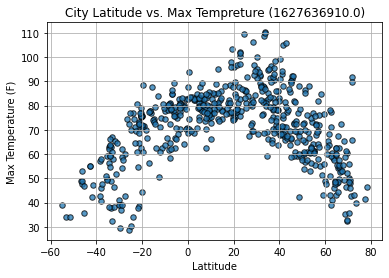

In [15]:
# Create a scatter plot which compares Max Temperature (F) vs. Latitude
scatter_df.plot(kind="scatter", x="Lattitude", y="Max Temperature (F)",marker="o", facecolors="blue",
edgecolors="black", s=30,alpha=0.75,figsize=(6,4), title=f"City Latitude vs. Max Tempreture ({Date})")
plt.grid(True)
plt.savefig("../Images/Latitude_vs._Temperature Plot.png", bbox_inches = "tight")

## Latitude vs. Humidity Plot

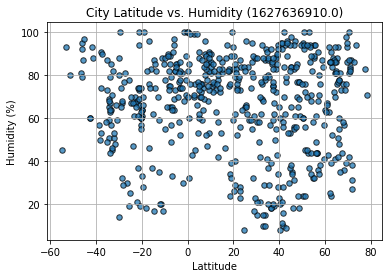

In [16]:
# Create a scatter plot which Humidity (%) vs. Latitude
scatter_df.plot(kind="scatter", x="Lattitude", y="Humidity (%)",marker="o", facecolors="blue",
edgecolors="black", s=30,alpha=0.75, 
figsize=(6,4), title=f"City Latitude vs. Humidity ({Date})")
plt.grid(True)
plt.savefig("../Images/Latitude_vs._Humidity_Plot.png", bbox_inches = "tight")

## Latitude vs. Cloudiness Plot

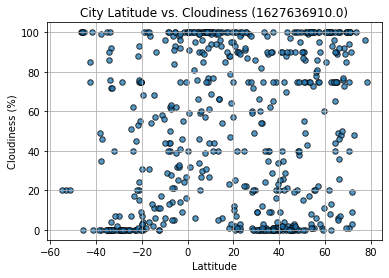

In [17]:
# Create a scatter plot which Cloudiness (%) vs. Latitude
scatter_df.plot(kind="scatter", x="Lattitude", y="Cloudiness (%)",marker="o", facecolors="blue",
edgecolors="black", s=30,alpha=0.75, 
figsize=(6,4), title=f"City Latitude vs. Cloudiness ({Date})")
plt.grid(True)
plt.savefig("../Images/Latitude_vs._Cloudiness_Plot.png", bbox_inches = "tight")

## Latitude vs. Wind Speed Plot

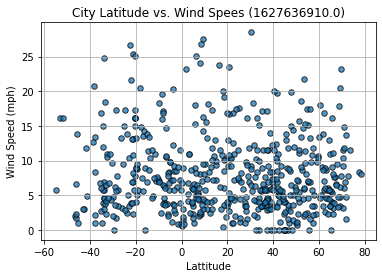

In [18]:
# Create a scatter plot which compares Wind Speed (mph) vs. Latitude
scatter_df.plot(kind="scatter", x="Lattitude", y="Wind Speed (mph)",marker="o", facecolors="blue",
edgecolors="black",alpha=0.75, s=30, 
figsize=(6,4), title=f"City Latitude vs. Wind Spees ({Date})")
plt.grid(True)
plt.savefig("../Images/Latitude_vs._Wind_Speed_Plot.png", bbox_inches = "tight")

## Linear Regression

In [19]:
# Select columns & prepare the complete dataframe
regression_df = scatter_df
regression_df

,Lattitude,Max Temperature (F),Humidity (%),Cloudiness (%),Wind Speed (mph),Date
0,54.7914,76.96,32.0,100.0,17.40,1.627637e+09
1,-7.7380,58.37,65.0,62.0,3.94,1.627637e+09
2,-46.6000,48.79,81.0,100.0,1.99,1.627637e+09
3,-21.3585,72.99,73.0,93.0,13.06,1.627637e+09
4,-30.1811,41.02,80.0,7.0,9.64,1.627637e+09
...,...,...,...,...,...,...
606,53.7453,62.49,68.0,100.0,15.23,1.627637e+09
607,26.0299,91.85,62.0,87.0,8.21,1.627637e+09
608,43.2128,67.39,95.0,90.0,5.75,1.627637e+09
609,62.1444,78.28,25.0,8.0,7.09,1.627637e+09


In [20]:
# prepare the dataframe for Northern Hemishpere
regression_nh_df = regression_df.loc[regression_df["Lattitude"] >=0]
regression_nh_df

,Lattitude,Max Temperature (F),Humidity (%),Cloudiness (%),Wind Speed (mph),Date
0,54.7914,76.96,32.0,100.0,17.40,1.627637e+09
10,34.5667,69.21,41.0,98.0,5.61,1.627637e+09
11,6.3005,78.57,76.0,96.0,5.01,1.627637e+09
13,37.0500,83.23,85.0,29.0,4.16,1.627637e+09
14,54.1001,73.38,34.0,8.0,11.41,1.627637e+09
...,...,...,...,...,...,...
606,53.7453,62.49,68.0,100.0,15.23,1.627637e+09
607,26.0299,91.85,62.0,87.0,8.21,1.627637e+09
608,43.2128,67.39,95.0,90.0,5.75,1.627637e+09
609,62.1444,78.28,25.0,8.0,7.09,1.627637e+09


In [21]:
# prepare the dataframe for Southern Hemishpere
regression_sh_df = regression_df.loc[regression_df["Lattitude"] <=0]
regression_sh_df

,Lattitude,Max Temperature (F),Humidity (%),Cloudiness (%),Wind Speed (mph),Date
1,-7.7380,58.37,65.0,62.0,3.94,1.627637e+09
2,-46.6000,48.79,81.0,100.0,1.99,1.627637e+09
3,-21.3585,72.99,73.0,93.0,13.06,1.627637e+09
4,-30.1811,41.02,80.0,7.0,9.64,1.627637e+09
6,-42.7826,54.91,60.0,85.0,3.00,1.627637e+09
...,...,...,...,...,...,...
591,-34.4342,38.12,68.0,0.0,11.90,1.627637e+09
599,-3.6667,80.40,81.0,33.0,7.18,1.627637e+09
601,-35.7167,50.92,58.0,0.0,6.82,1.627637e+09
602,-21.8019,37.87,61.0,88.0,3.83,1.627637e+09


####  Northern Hemisphere - Max Temp vs. Latitude Linear Regression

The r-value is: -0.5993655288017196


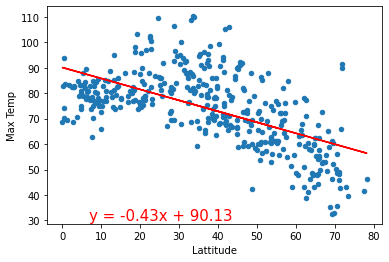

In [22]:
# Calculate the correlation coefficient and linear regression model 
# for Max Temp vs. Latitude Linear Regression in the Northern Hemisphere

# Plot out Max temp versus Lattitude
regression_nh_df.plot(kind="scatter", x="Lattitude", y="Max Temperature (F)")
plt.xlabel('Lattitude')
plt.ylabel('Max Temp')

# Define scatter values for x and y axis
x_values = regression_nh_df['Lattitude']
y_values = regression_nh_df['Max Temperature (F)']

# Compute regression line
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)

# Get y_axis values for the the regression line and add to plot
regress_values = x_values * slope + intercept


plt.plot(x_values,regress_values,"r-")

# Get string with the equation formula and add to plot
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(7,30),fontsize=15,color="red")
plt.savefig("../Images/Northern Hemisphere_Max Temp_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Southern Hemisphere - Max Temp vs. Latitude Linear Regression

The r-value is: 0.7086130195061205


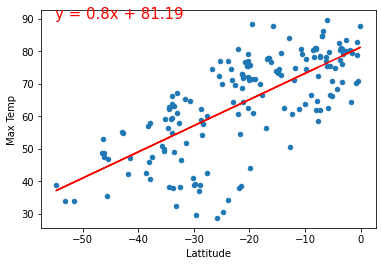

In [23]:
# Calculate the correlation coefficient and linear regression model 
# for Max Temp vs. Latitude Linear Regression in the Southern Hemisphere

# Plot out Max temp versus Lattitude
regression_sh_df.plot(kind="scatter", x="Lattitude", y="Max Temperature (F)")
plt.xlabel('Lattitude')
plt.ylabel('Max Temp')

# Define scatter values for x and y axis
x_values = regression_sh_df['Lattitude']
y_values = regression_sh_df['Max Temperature (F)']

# Compute regression line
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)

# Get y_axis values for the the regression line and add to plot
regress_values = x_values * slope + intercept


plt.plot(x_values,regress_values,"r-")

# Get string with the equation formula and add to plot
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(-55,90),fontsize=15,color="red")
plt.savefig("../Images/Southern_Hemisphere_Max Temp_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Northern Hemisphere - Humidity (%) vs. Latitude Linear Regression

The r-value is: -0.07100480885219869


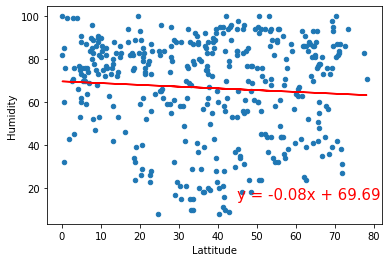

In [24]:
# Calculate the correlation coefficient and linear regression model 
# for Humidity vs. Latitude Linear Regression in the Northern Hemisphere
regression_nh_df.plot(kind="scatter", x="Lattitude", y="Humidity (%)")
plt.xlabel('Lattitude')
plt.ylabel('Humidity')
x_values = regression_nh_df['Lattitude']
y_values = regression_nh_df['Humidity (%)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(45,15),fontsize=15,color="red")
plt.savefig("../Images/Northern_Hemisphere_Humidity_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Southern Hemisphere - Humidity (%) vs. Latitude Linear Regression

The r-value is: 0.0627892868191017


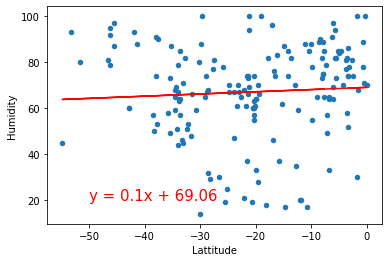

In [25]:
# Calculate the correlation coefficient and linear regression model 
# for Humidity vs. Latitude Linear Regression in the Southern Hemisphere
regression_sh_df.plot(kind="scatter", x="Lattitude", y="Humidity (%)")
plt.xlabel('Lattitude')
plt.ylabel('Humidity')
x_values = regression_sh_df['Lattitude']
y_values = regression_sh_df['Humidity (%)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(-50,20),fontsize=15,color="red")
plt.savefig("../Images/Southern_Hemisphere_Humidity_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Northern Hemisphere - Cloudiness (%) vs. Latitude Linear Regression

The r-value is: -0.09646601036428014


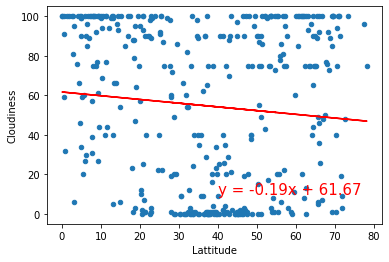

In [26]:
# Calculate the correlation coefficient and linear regression model 
# for Cloudiness (%) vs. Latitude Linear Regression in the Northern Hemisphere
regression_nh_df.plot(kind="scatter", x="Lattitude", y="Cloudiness (%)")
plt.xlabel('Lattitude')
plt.ylabel('Cloudiness')
x_values = regression_nh_df['Lattitude']
y_values = regression_nh_df['Cloudiness (%)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(40,10),fontsize=15,color="red")
plt.savefig("../Images/Northern_Hemisphere_Cloudiness_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Southern Hemisphere - Cloudiness (%) vs. Latitude Linear Regression

The r-value is: 0.13335416955050722


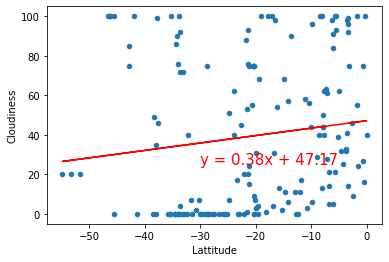

In [27]:
# Calculate the correlation coefficient and linear regression model 
# for Cloudiness (%) vs. Latitude Linear Regression in the Southern Hemisphere
regression_sh_df.plot(kind="scatter", x="Lattitude", y="Cloudiness (%)")
plt.xlabel('Lattitude')
plt.ylabel('Cloudiness')
x_values = regression_sh_df['Lattitude']
y_values = regression_sh_df['Cloudiness (%)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(-30,25),fontsize=15,color="red")
plt.savefig("../Images/Southern_Hemisphere_Cloudiness_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Northern Hemisphere - Wind Speed (mph) vs. Latitude Linear Regression

The r-value is: -0.029106530821259437


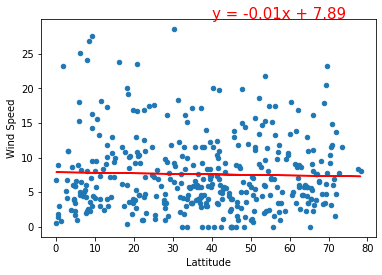

In [28]:
# Calculate the correlation coefficient and linear regression model 
# for Wind Speed (mph) vs. Latitude Linear Regression in the Northern Hemisphere
regression_nh_df.plot(kind="scatter", x="Lattitude", y="Wind Speed (mph)")
plt.xlabel('Lattitude')
plt.ylabel('Wind Speed')
x_values = regression_nh_df['Lattitude']
y_values = regression_nh_df['Wind Speed (mph)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(40,30),fontsize=15,color="red")
plt.savefig("../Images/Northern_Hemisphere_Cloudiness_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Southern Hemisphere - Wind Speed (mph) vs. Latitude Linear Regression

The r-value is: -0.0019671295632594605


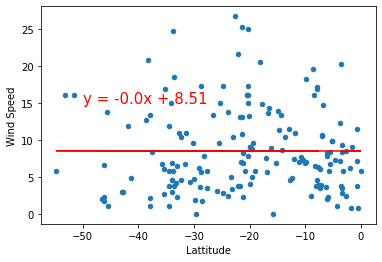

In [29]:
# Calculate the correlation coefficient and linear regression model 
# for Wind Speed (mph) vs. Latitude Linear Regression in the Southern Hemisphere
regression_sh_df.plot(kind="scatter", x="Lattitude", y="Wind Speed (mph)")
plt.xlabel('Lattitude')
plt.ylabel('Wind Speed')
x_values = regression_sh_df['Lattitude']
y_values = regression_sh_df['Wind Speed (mph)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(-50,15),fontsize=15,color="red")
plt.savefig("../Images/Southern_Hemisphere_Wind_Speed_(mph)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()